# KASZCZ - notes
# 

In [1]:
using Plots
using StatsBase
using Distributions
using StatsFuns
using KernelDensity
using Statistics
using StatsPlots
using CSV
using DataFrames
using LaTeXStrings
using LsqFit
using DelimitedFiles

In [2]:
function pMA(X, p)
    S = Float64[]
    for i in p+1 : length(X)-p
        s = mean(X[i-p:i+p])
        append!(S, s)
    end
    return S
end


function regression(X, Y, display_plot=true)
    r = cor(X, Y)
    Sx = std(X)
    Sy = std(Y)
    a = r * Sy / Sx
    b = mean(Y) - a * mean(X)

    if display_plot
        scatter(X, Y, ms=2, markerstrokewidth=0.5, alpha=0.5)
        xs = minimum(X):0.01:maximum(X)
        plot!(xs, a .* xs .+ b, c=:red, lw=2) |> display
    end

    return [a, b]
end


function RSP(X, Y)
    C = cumsum(Y.^2)
    n = length(X)
    es = Float64[]
    for k in 2:n-2
        X1 = X[1:k]
        X2 = X[k+1:n]
        C1 = C[1:k]
        C2 = C[k+1:n]
        a1, b1 = regression(X1, C1, false)
        a2, b2 = regression(X2, C2, false)
        e = sum((C1 .- a1 .* X1 .- b1).^2) + sum((C2 .- a2 .* X2 .- b2).^2)
        append!(es, e)
    end
    return X[argmin(es) + 1]
end

RSP (generic function with 1 method)

# Pierwsze zajęcia

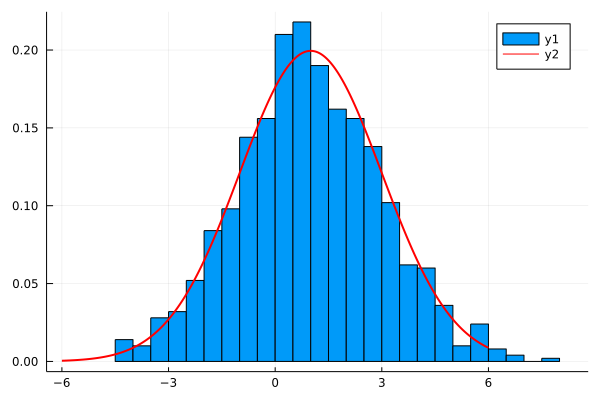

In [21]:
X = rand(Normal(1, 2), 1000)
histogram(X, bins=30, norm=true)

xs = -6:0.01:6
plot!(xs, pdf.(Normal(1, 2), xs), color=:red, lw=2)

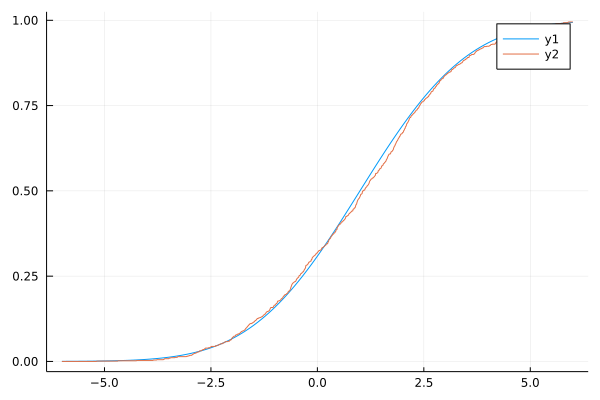

In [28]:
X = rand(Normal(1, 2), 1000)
F = ecdf(X)
xs = -6:0.01:6
plot(xs, cdf.(Normal(1, 2), xs))
plot!(xs, F.(xs))

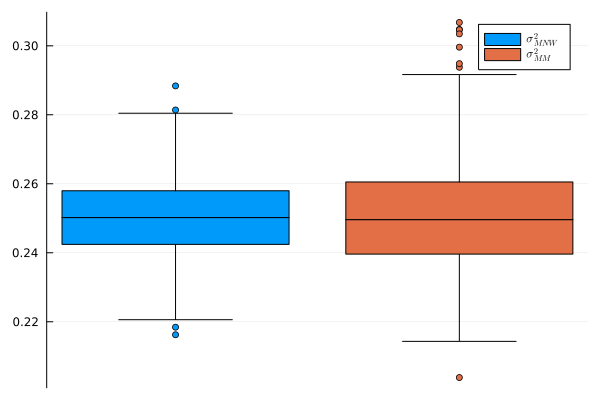

In [12]:
n = 1000
MC = 1000
σs_mnw = Float64[]
σs_mm = Float64[]

for i in 1:MC

    X = rand(Normal(1, 0.5), n)
    Y = exp.(X)

    μ_mnw = 1/n * sum(log.(Y))
    σ_mnw = 1/n * sum((log.(Y) .- μ_mnw).^2)

    m1 = 1/n * sum(Y)
    m2 = 1/n * sum(Y.^2)
    σ_mm = log(m2) - 2 * log(m1)

    append!(σs_mnw, σ_mnw)
    append!(σs_mm, σ_mm)
end

boxplot(σs_mnw, label=L"\sigma^2_{MNW}")
boxplot!(σs_mm, label=L"\sigma^2_{MM}", xticks=false, xaxis=false)

# Lista 1

## Zadanie 1

In [7]:
file = open("zad1_lista1.txt")
data = readlines(file)
close(file)
data

1000-element Vector{String}:
 "   2.0490626e-01  -3.2205502e+00"
 "   9.8945649e-02  -1.1258680e+00"
 "   2.0636720e+00   1.2928829e+01"
 "   9.0607812e-02   6.9178623e+00"
 "   4.5829762e-01  -6.0477376e-01"
 "   2.3274886e+00   1.0360501e+01"
 "   1.2783436e+00   3.4827574e+00"
 "   6.0352310e-01   8.1949464e+00"
 "   4.3422419e-02  -7.8077760e-01"
 "   3.5742692e-02   1.0832976e+01"
 ⋮
 "   2.0513202e-01   1.0432906e+01"
 "   2.3689579e-01   8.1933621e+00"
 "   1.5985907e-01  -3.7372587e-02"
 "   6.8193701e-01   9.5902234e+00"
 "   4.5308926e-01   2.7684125e+00"
 "   5.0352247e-02   1.6329001e+00"
 "   8.1201145e-01   7.2318393e+00"
 "   2.8130971e+00   6.2687607e+00"
 "   1.4300481e-01  -8.8030861e+00"

In [8]:
data_split = split.(data, "  ")
X = parse.(Float64, getindex.(data_split, 2))
Y = parse.(Float64, getindex.(data_split, 3))

1000-element Vector{Float64}:
 -3.2205502
 -1.125868
 12.928829
  6.9178623
 -0.60477376
 10.360501
  3.4827574
  8.1949464
 -0.7807776
 10.832976
  ⋮
 10.432906
  8.1933621
 -0.037372587
  9.5902234
  2.7684125
  1.6329001
  7.2318393
  6.2687607
 -8.8030861

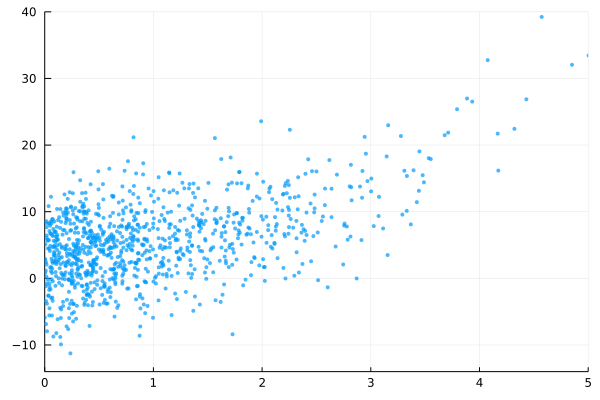

In [14]:
scatter(X, Y, ylim=(-14, 40), xlim=(0, 5), ms=3, alpha=0.7, markerstrokewidth=0, legend=false)

$$ f(t) = \alpha t^{\beta} + \gamma $$ 

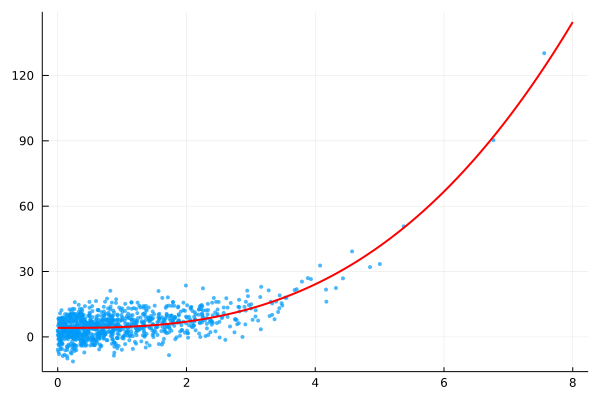

α = 0.4078832207120928
β = 2.8090539813480393
ω = 4.131594743153594


In [24]:
f_mod(t, p) = p[1] .* t .^ p[2] .+ p[3]
f_fit = curve_fit(f_mod, X, Y, [1.5, 2, 0])

xs = 0:0.01:8
scatter(X, Y, ms=3, alpha=0.7, markerstrokewidth=0, legend=false)
plot!(xs, f_mod(xs, f_fit.param), lw=2, c=:red) |> display

symbols = ["α", "β", "ω"]
for param in zip(symbols, f_fit.param) 
    println(param[1], " = ", param[2])
end

In [117]:
cor(X, Y)

0.5904985680866514

In [121]:
corspearman(X, Y)

0.39694022494022496

## Zadanie 2

In [25]:
file = open("zad2_lista1.txt")
lines = readlines(file)
close(file)
data = parse.(Float64, lines)

10000-element Vector{Float64}:
  1.8386764
  1.855805
  0.69752129
  1.2962382
  0.75562108
  1.626694
  0.94778493
  1.1341207
  1.4429193
  2.7800594
  ⋮
 -0.50943653
 -0.41153596
  1.0593411
  0.16641131
 -0.2649519
  1.8417961
 -0.019291102
  0.016198161
  2.3294532

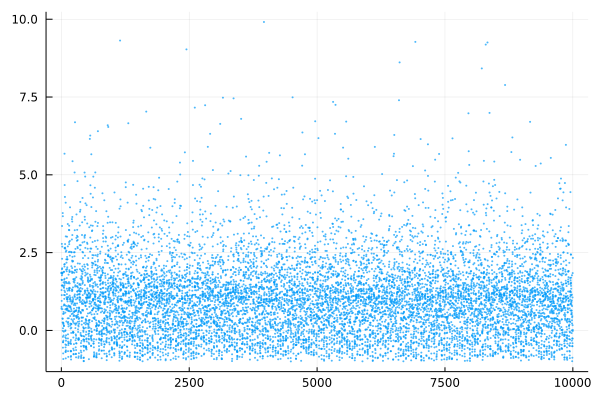

In [33]:
scatter(data, ms=2, alpha=0.7, markerstrokewidth=0, legend=false)

In [16]:
function pMA(X, p)
    S = Float64[]
    for i in p+1 : length(X)-p
        s = mean(X[i-p:i+p])
        append!(S, s)
    end
    return S
end

pMA (generic function with 1 method)

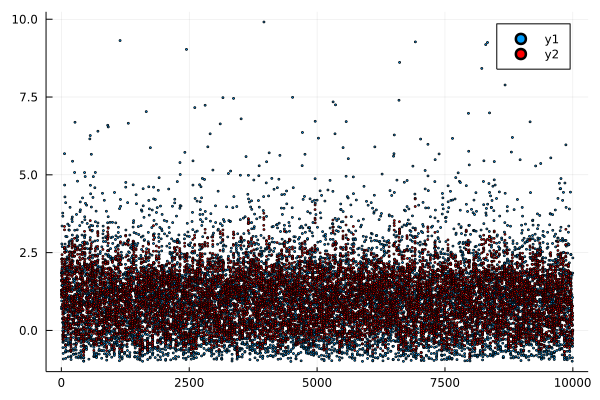

In [36]:
preprocessed_data = pMA(data, 2) # podstawa 5
scatter(data, ms=2)
scatter!(preprocessed_data, ms=2, c=:red)

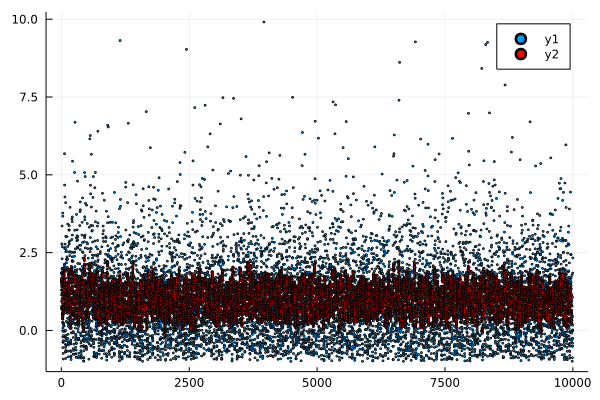

In [31]:
preprocessed_data = pMA(data, 12) # podstawa 25
scatter(data, ms=2)
scatter!(preprocessed_data, ms=2, c=:red)

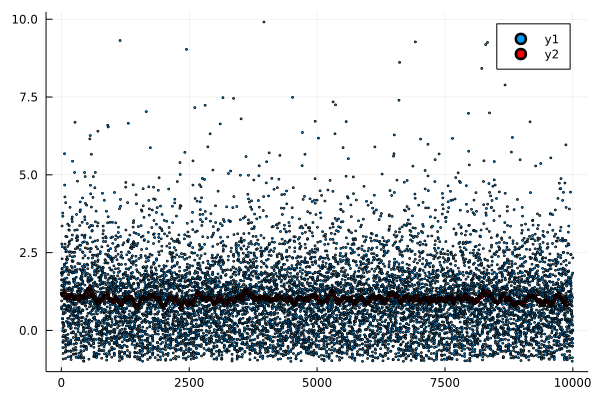

In [32]:
preprocessed_data = pMA(data, 50) # podstawa 101
scatter(data, ms=2)
scatter!(preprocessed_data, ms=2, c=:red)

In [5]:
quantile(TDist(10), 0.975)

2.228138851986274

## Zadanie 3

In [52]:
file = open("zad2_lista1.txt")
X_data = readlines(file)
X = parse.(Float64, X_data)
close(file)

file = open("zad3_lista1.txt")
Y_data = readlines(file)
close(file)
Y = parse.(Float64, Y_data)

10000-element Vector{Float64}:
  53.341964
  42.770981
  19.559566
  49.174287
  38.698249
  12.246389
  -1.4814907
  54.864702
  28.310769
  63.95491
   ⋮
 -12.150652
  -6.1209765
  19.446872
  19.968815
  15.243152
  61.493194
 -13.723898
  25.326425
  45.053463

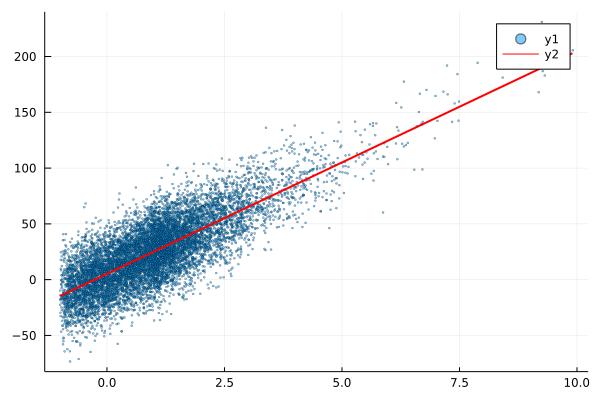

a = 19.966464658199953
b = 5.226906171237204


In [54]:
coefs = regression(X, Y)

println("a = ", coefs[1])
println("b = ", coefs[2])

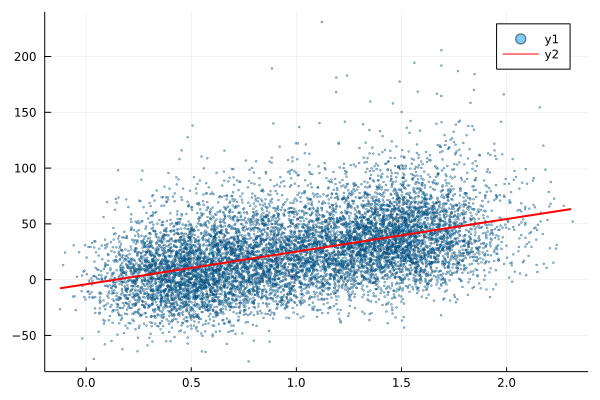

a = 29.223564562142816
b = -4.115475419277761


In [57]:
p = 12
pp_X = pMA(X, p)
pp_Y = Y[p+1:end-p]

coefs = regression(pp_X, pp_Y)

println("a = ", coefs[1])
println("b = ", coefs[2])

## Zadanie 4

In [67]:
file = open("zad4_lista1.txt")
data = readlines(file)
close(file)

data_split = split.(data, "  ")
X = parse.(Float64, getindex.(data_split, 2))
Y = parse.(Float64, getindex.(data_split, 3))

1000-element Vector{Float64}:
  -10.540233
  105.54756
  -74.450026
  126.48209
  -41.060126
 -125.29002
  -28.832421
    7.5050591
  -14.331769
   94.023283
    ⋮
   18.833329
   12.925807
   54.942966
   50.044675
  -52.186251
 -163.66101
   89.02319
   64.595188
  138.25404

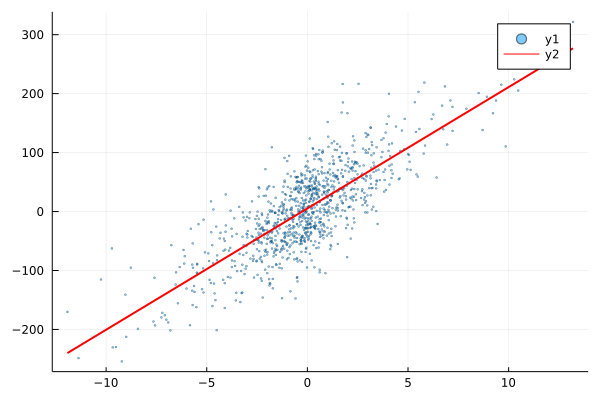

a = 20.578831014287932
b = 5.285173853754354


In [68]:
coefs = regression(X, Y)

println("a = ", coefs[1])
println("b = ", coefs[2])

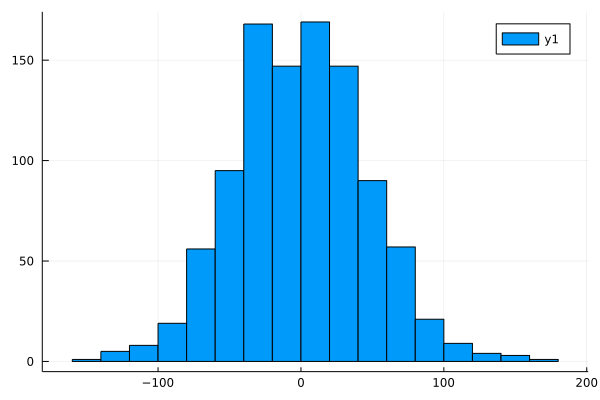

In [70]:
a = coefs[1]
b = coefs[2]
e = Y .- (a .* X .+ b)
histogram(e)

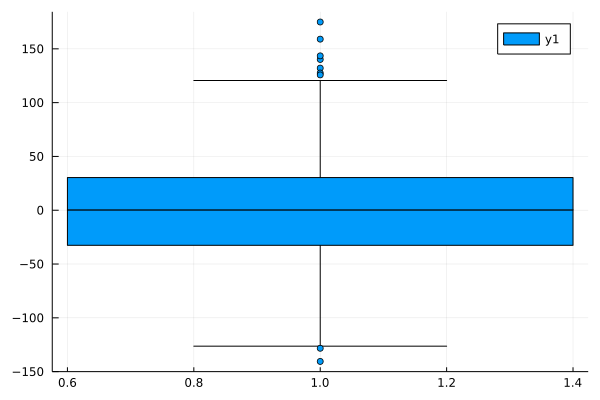

In [71]:
boxplot(e)

In [72]:
new_X = Float64[]
new_Y = Float64[]

for (x, y) in zip(X, Y)
    if abs(y - (a*x + b)) < 100
        append!(new_X, x)
        append!(new_Y, y)
    end
end

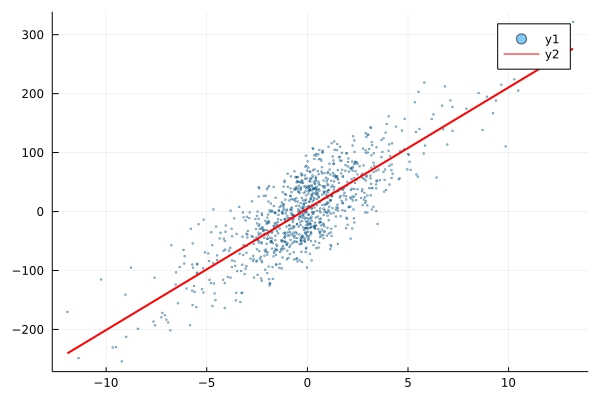

a = 20.578650447363362
b = 4.807054584999779


In [73]:
coefs = regression(new_X, new_Y)

println("a = ", coefs[1])
println("b = ", coefs[2])

## Zadanie 5

In [74]:
file = open("zad4_lista1.txt")
data = readlines(file)
close(file)

data_split = split.(data, "  ")
X = parse.(Float64, getindex.(data_split, 2))
Y = parse.(Float64, getindex.(data_split, 3))

1000-element Vector{Float64}:
  -10.540233
  105.54756
  -74.450026
  126.48209
  -41.060126
 -125.29002
  -28.832421
    7.5050591
  -14.331769
   94.023283
    ⋮
   18.833329
   12.925807
   54.942966
   50.044675
  -52.186251
 -163.66101
   89.02319
   64.595188
  138.25404

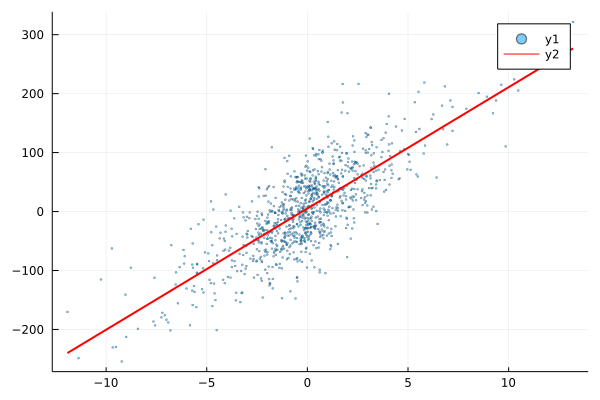

a = 20.570106217187895
b = 5.228135761231345


In [77]:
new_X = X[1:990]
new_Y = Y[1:990]

a, b = regression(new_X, new_Y)

println("a = ", a)
println("b = ", b)

In [69]:
e = Y[991:end] .- (a .* X[991:end] .+ b)

10-element Vector{Float64}:
  47.6918212411462
  18.08146598335252
  11.217227726087923
   4.441877764297644
   4.036258408959974
 -19.833915545175408
 -84.46272399126542
  76.6880615592219
  44.35408610520411
 -46.0833094536479

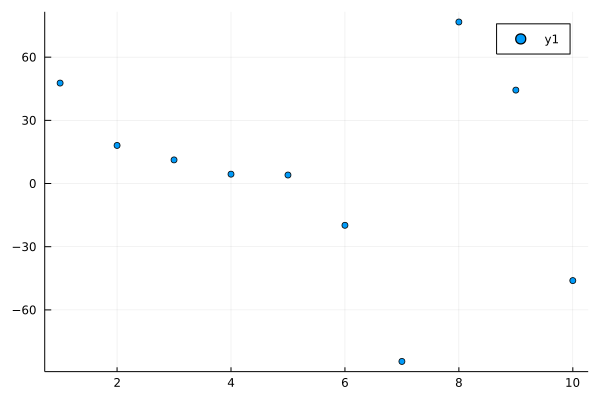

In [70]:
scatter(e)

## Zadanie 6

In [80]:
data = readdlm("zad6_lista1.txt", Float64)
X = data[:, 1]
Y = data[:, 2]

1000-element Vector{Float64}:
  2.2890677
  0.87899067
  9.2051617
  5.8202303
 45.163982
  2.4748689
  1.9735702
 29.245859
  2.1058236
  4.088961
  ⋮
  0.63666903
  6.8350285
  1.7111825
  1.5833001
  1.4407737
  7.8706791
  0.8558228
  4.0991213
  2.2475017

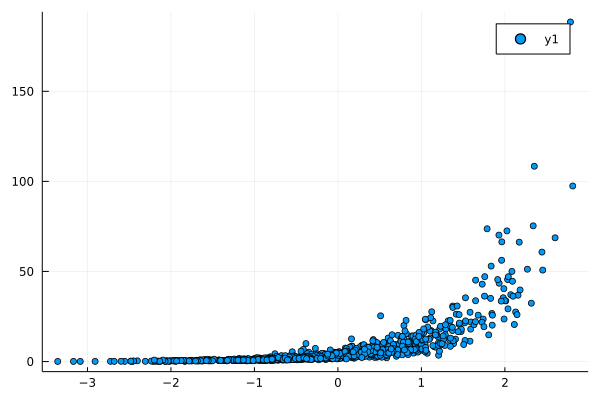

In [81]:
scatter(X, Y)

$$ \alpha \exp{(\beta t)} + \gamma $$

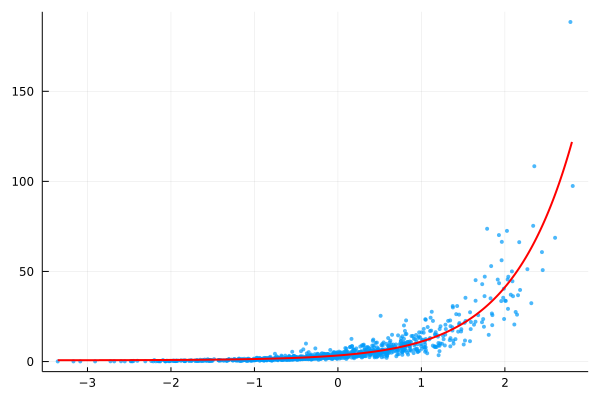

α = 2.656625668032957
β = 1.3626061164093242
γ = 0.7059278523859999


In [82]:
f_mod(t, p) = p[1] .* exp.(p[2] .* t) .+ p[3]
f_fit = curve_fit(f_mod, X, Y, [1.0, 1.0, 0.0])

xs = minimum(X):0.01:maximum(X)
scatter(X, Y, ms=3, alpha=0.7, markerstrokewidth=0, legend=false)
plot!(xs, f_mod(xs, f_fit.param), lw=2, c=:red) |> display

symbols = ["α", "β", "γ"]
for param in zip(symbols, f_fit.param) 
    println(param[1], " = ", param[2])
end

$$ y = a\exp{(bt)} $$
$$ \log{y} = \log{a} + bt $$
$$ y_i = b_1 t + b_0 $$

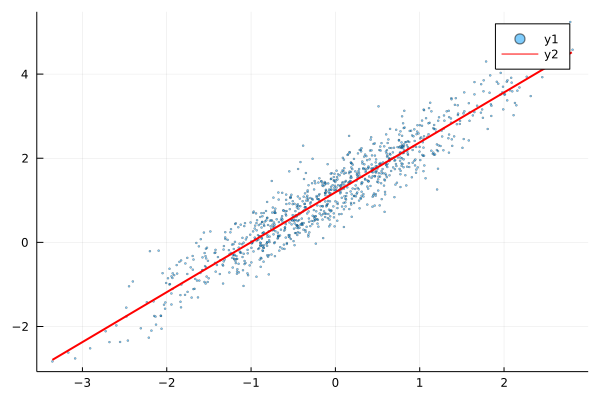

b₁ = 1.1869261103422117
b₀ = 1.1904809318009155


In [83]:
new_Y = log.(Y)
coefs = regression(X, new_Y)

println("b₁ = ", coefs[1])
println("b₀ = ", coefs[2])

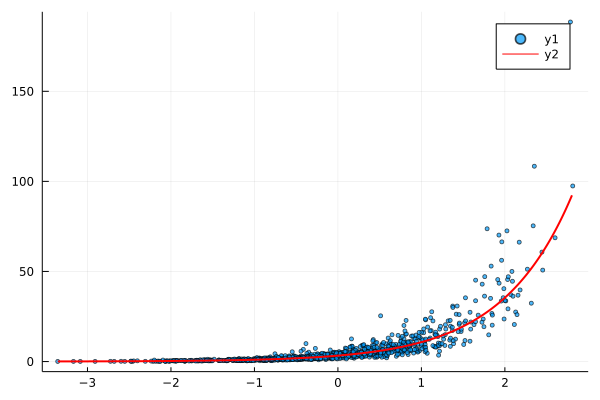

In [50]:
b1 = coefs[1]
b0 = coefs[2]

scatter(X, Y, ms=3, alpha=0.7)
xs = minimum(X):0.01:maximum(X)
plot!(xs, exp(b1) .* exp.(b0.*xs), lw=2, c=:red)

In [78]:
r² = sum( (b0 .+ b1 .* X .- mean(new_Y)).^2 ) / sum( (new_Y .- mean(new_Y)).^2 )

0.00270800178898233

# Lista 2

## Zadanie 1 (e)

σ = 10 :   β1 = 2.999739206951709,   Wartość estym. wariancji 0.00030481939977230804     Wartość teoret. wariancji: 0.0002955519432540269
σ = 20 :   β1 = 2.9994700534115015,   Wartość estym. wariancji 0.001226095626665055     Wartość teoret. wariancji: 0.0011822077730161075
σ = 30 :   β1 = 2.998876306702142,   Wartość estym. wariancji 0.002612275595993912     Wartość teoret. wariancji: 0.0026599674892862422


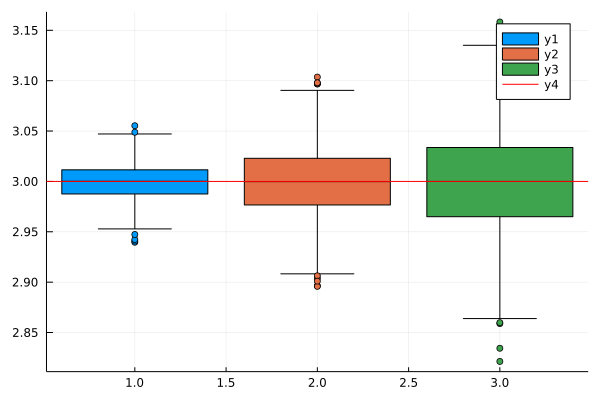

In [7]:
n = 100
β1 = 3
σ = [10, 20, 30]
X = 1:1:n

boxplot()
for sigma in σ
    βs = Float64[]
    for i in 1:1000
        Y = β1 .* X .+ rand(Normal(0, sigma), n)
        β = sum(X.*Y) / sum(X.^2)
        append!(βs, β)
    end
    println("σ = ", sigma, " :   β1 = ", mean(βs), ",   Wartość estym. wariancji ", var(βs), "     Wartość teoret. wariancji: ", sigma^2 / sum(X.^2))
    boxplot!(βs)
end

hline!([3], c=:red)

n = 100 :   β1 = 2.9994407425564003,   Wartość estym. wariancji: 0.0011694063403718644     Wartość teoret. wariancji: 0.0011822077730161075
n = 500 :   β1 = 3.000688345104435,   Wartość estym. wariancji: 0.00022764172228928158     Wartość teoret. wariancji: 0.00023736945646140532
n = 1000 :   β1 = 2.9994345061113723,   Wartość estym. wariancji: 0.00011749909785096158     Wartość teoret. wariancji: 0.00011874245323513011


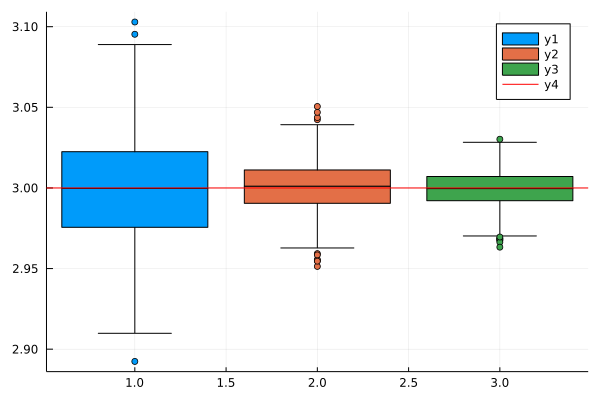

In [8]:
ns = [100, 500, 1000]
β1 = 3
σ = 20

boxplot()
for n in ns
    βs = Float64[]
    X = LinRange(1, 100, n)
    for i in 1:1000
        Y = β1 .* X .+ rand(Normal(0, σ), n)
        β = sum(X.*Y) / sum(X.^2)
        append!(βs, β)
    end
    println("n = ", n, " :   β1 = ", mean(βs), ",   Wartość estym. wariancji: ", var(βs), "     Wartość teoret. wariancji: ", σ^2 / sum(X.^2))
    boxplot!(βs)
end

hline!([3], c=:red)

## Zadanie 2

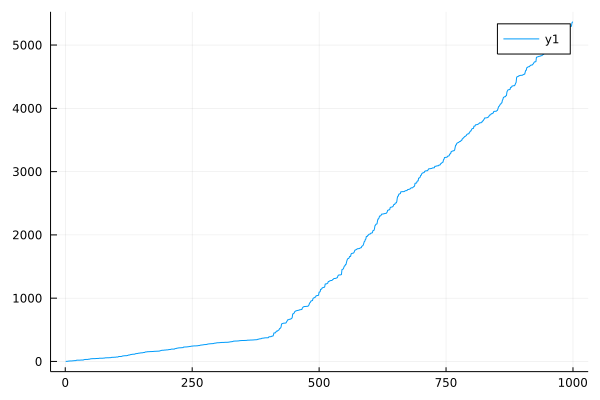

In [17]:
X = 1:1000
Y1 = rand(Normal(0, 1), 400)
Y2 = rand(Normal(0, 3), 600)
Y = vcat(Y1, Y2)
C = cumsum(Y.^2)
plot(X, C)

In [18]:
function RSP(X, Y)
    C = cumsum(Y.^2)
    n = length(X)
    es = Float64[]
    for k in 2:n-2
        X1 = X[1:k]
        X2 = X[k+1:n]
        C1 = C[1:k]
        C2 = C[k+1:n]
        a1, b1 = regression(X1, C1, false)
        a2, b2 = regression(X2, C2, false)
        e = sum((C1 .- a1 .* X1 .- b1).^2) + sum((C2 .- a2 .* X2 .- b2).^2)
        append!(es, e)
    end
    return X[argmin(es) + 1]
end

RSP (generic function with 1 method)

In [35]:
X = 1:10000
Y1 = rand(Normal(0, 1), 4000)
Y2 = rand(Normal(0, 10), 6000)
Y = vcat(Y1, Y2)
RSP(X, Y)

4023

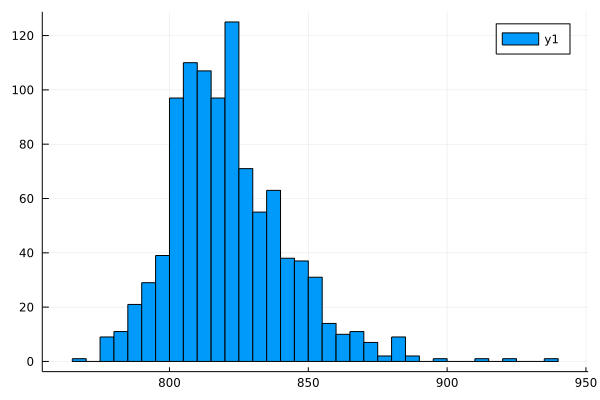

820.724


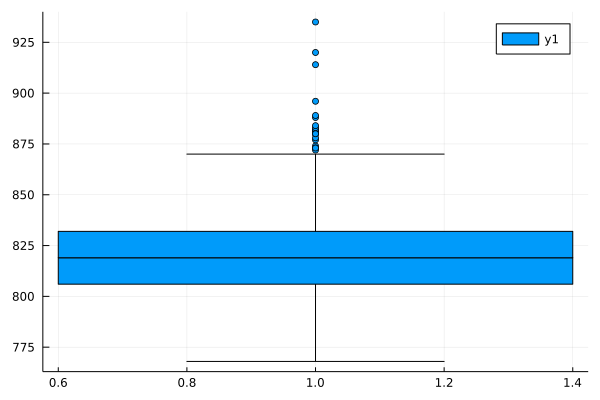

In [37]:
X = 1:2000
τs = Float64[]
for i in 1:1000
    Y1 = rand(Normal(0, 2), 800)
    Y2 = rand(Normal(0, 4), 1200)
    Y = vcat(Y1, Y2)
    append!(τs, RSP(X, Y))
end
mean(τs) |> println
histogram(τs) |> display
boxplot(τs)

## Moja metoda

In [147]:
function RSP2(X, Y)
    n = length(X)
    δs = Float64[]
    Z = Y.^2
    for k in 50:n-51
        Z1 = Z[1:k]
        Z2 = Z[k+1:n]
        δ = abs(mean(Z1) - mean(Z2))
        append!(δs, δ)
    end
    return X[argmax(δs) + 49]
end

RSP2 (generic function with 1 method)

In [148]:
X = 1:1000
Y1 = rand(Normal(0, 1), 400)
Y2 = rand(Normal(0, 10), 600)
Y = vcat(Y1, Y2)
RSP2(X, Y)

401

503.08


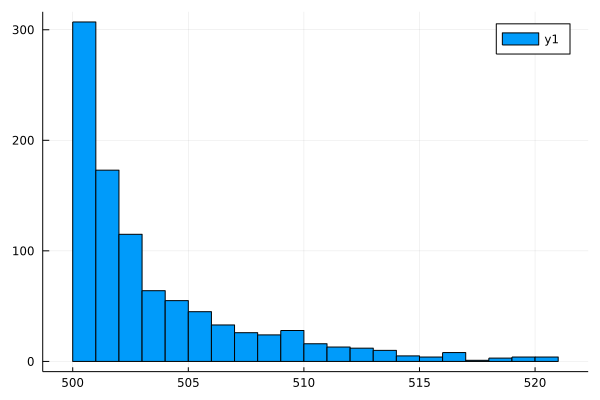

In [171]:
X = 1:1000
τs = Float64[]
for i in 1:1000
    Y1 = rand(Normal(0, 1), 500)
    Y2 = rand(Normal(0, 10), 500)
    Y = vcat(Y1, Y2)
    append!(τs, RSP2(X, Y))
end
mean(sort(τs)[1:950]) |> println
histogram(sort(τs)[1:950])

## Zadanie 3

In [33]:
n = 1000
X = LinRange(0, 10, n)
β0 = 3
β1 = 2
σ = 1
β0s = Float64[]
β1s = Float64[]

for i in 1:1000
    Y = β1 .* X .+ β0 .+ rand(Normal(0, σ), n)
    β1_, β0_ = regression(X, Y, false)
    append!(β0s, β0_)
    append!(β1s, β1_)
end

println("Estymator średniej β0:  ", mean(β0s), "      Wartość teoretyczna średniej β0:  ", β0)
println("Estymator wariancji β0:  ", std(β0s), "      Wartość teoretyczna wariancji β0:  ", σ * sqrt(1/n + mean(X)^2 / sum((X .- mean(X)).^2)))
println("Estymator średniej β1:  ", mean(β1s), "      Wartość teoretyczna średniej β1:  ", β1)
println("Estymator wariancji β1:  ", std(β1s), "      Wartość teoretyczna wariancji β1:  ", σ / sqrt(sum((X .- mean(X)).^2)))

Estymator średniej β0:  2.9965712397737985      Wartość teoretyczna średniej β0:  3
Estymator wariancji β0:  0.06389403290803178      Wartość teoretyczna wariancji β0:  0.0631981486596403
Estymator średniej β1:  2.0004917139305936      Wartość teoretyczna średniej β1:  2
Estymator wariancji β1:  0.011168484063945366      Wartość teoretyczna wariancji β1:  0.010943502170705673


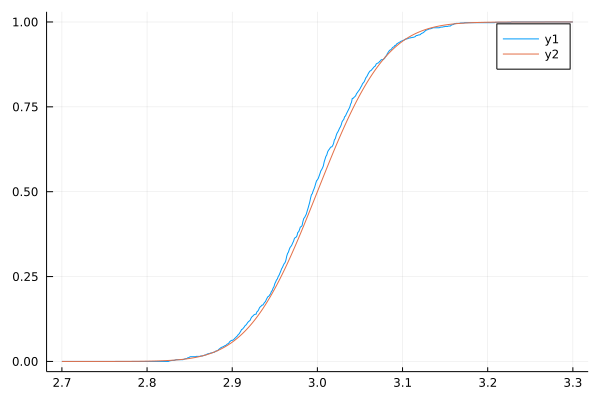

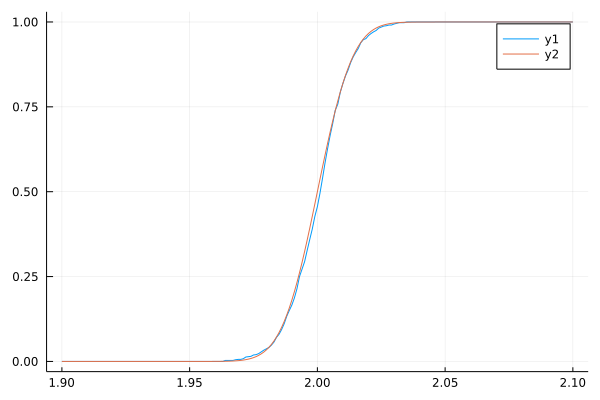

In [34]:
F0 = ecdf(β0s)
xs = 2.7:0.001:3.3
plot(xs, F0.(xs))
plot!(xs, cdf.(Normal(β0, σ * sqrt(1/n + mean(X)^2 / sum((X .- mean(X)).^2))), xs)) |> display

F1 = ecdf(β1s)
xs = 1.9:0.001:2.1
plot(xs, F1.(xs))
plot!(xs, cdf.(Normal(β1, σ / sqrt(sum((X .- mean(X)).^2))), xs))

# Lista 3

## Zadanie 1, 2

In [27]:
β0 = 3
β1 = 2
σ = 1
α = 0.05
n = 300
M = 10000

z = quantile(Normal(0, 1), 1 - α/2)
t = quantile(TDist(n - 2), 1 - α/2)

p0_z = 0
p0_n = 0
p1_z = 0
p1_n = 0

for i in 1:M
    X = 1:n
    E = rand(Normal(0, σ), n)
    Y = β1 .* X .+ β0 .+ E
    β1_, β0_ = regression(X, Y, false)
    S = sqrt(sum((Y .- β1 .* X .- β0).^2) / (n - 2))
    p0_z += β0_ - z * σ * sqrt(1/n + mean(X)^2 / sum((X .- mean(X)).^2)) < β0 < β0_ + z * σ * sqrt(1/n + mean(X)^2 / sum((X .- mean(X)).^2))
    p0_n += β0_ - t * S * sqrt(1/n + mean(X)^2 / sum((X .- mean(X)).^2)) < β0 < β0_ + t * S * sqrt(1/n + mean(X)^2 / sum((X .- mean(X)).^2))
    p1_z += β1_ - z * σ / sqrt(sum((X .- mean(X)).^2)) < β1 < β1_ + z * σ / sqrt(sum((X .- mean(X)).^2))
    p1_n += β1_ - t * S / sqrt(sum((X .- mean(X)).^2)) < β1 < β1_ + t * S / sqrt(sum((X .- mean(X)).^2))
end

println("p0_z = ", p0_z/M)
println("p0_n = ", p0_n/M)
println("p1_z = ", p1_z/M)
println("p1_n = ", p1_n/M)

p0_z = 0.9502
p0_n = 0.9513
p1_z = 0.9524
p1_n = 0.9538


In [28]:
function confidence_interval(β0, β1, σ, n, α, M)

    z = quantile(Normal(0, 1), 1 - α/2)
    t = quantile(TDist(n - 2), 1 - α/2)

    p0_z = 0
    p0_n = 0
    p1_z = 0
    p1_n = 0

    for i in 1:M
        X = 1:n
        E = rand(Normal(0, σ), n)
        Y = β1 .* X .+ β0 .+ E
        β1_, β0_ = regression(X, Y, false)
        S = sqrt(sum((Y .- β1 .* X .- β0).^2) / (n - 2))
        p0_z += β0_ - z * σ * sqrt(1/n + mean(X)^2 / sum((X .- mean(X)).^2)) < β0 < β0_ + z * σ * sqrt(1/n + mean(X)^2 / sum((X .- mean(X)).^2))
        p0_n += β0_ - t * S * sqrt(1/n + mean(X)^2 / sum((X .- mean(X)).^2)) < β0 < β0_ + t * S * sqrt(1/n + mean(X)^2 / sum((X .- mean(X)).^2))
        p1_z += β1_ - z * σ / sqrt(sum((X .- mean(X)).^2)) < β1 < β1_ + z * σ / sqrt(sum((X .- mean(X)).^2))
        p1_n += β1_ - t * S / sqrt(sum((X .- mean(X)).^2)) < β1 < β1_ + t * S / sqrt(sum((X .- mean(X)).^2))
    end

    return [p0_z/M, p0_n/M, p1_z/M, p1_n/M]
end

confidence_interval (generic function with 1 method)

In [43]:
ns = [100, 200, 300]
DataFrame(confidence_interval.(3, 2, 1, ns, 0.05, 10000), :auto)

,x1,x2,x3
,Float64,Float64,Float64
1,0.9479,0.9519,0.9488
2,0.956,0.9542,0.9499
3,0.9516,0.9549,0.9501
4,0.9555,0.9568,0.9522


In [51]:
σs = [0.01, 0.5, 1]
df = DataFrame(confidence_interval.(3, 2, σs, 100, 0.05, 10000), :auto)

,x1,x2,x3
,Float64,Float64,Float64
1,0.9543,0.9489,0.9537
2,0.9593,0.9548,0.9571
3,0.9535,0.9511,0.9502
4,0.9574,0.9566,0.9561


## Zadanie 4

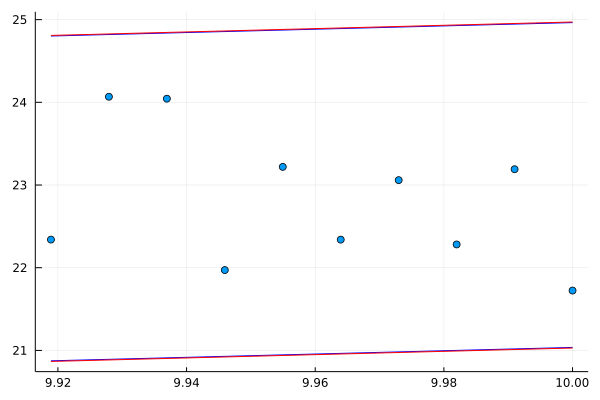

In [69]:
β0 = 3
β1 = 2
σ = 1
n = 990
α = 0.05

z = quantile(Normal(0, 1), 1 - α/2)
t = quantile(TDist(n - 2), 1 - α/2)

X = LinRange(1, 10, 1000)
E = rand(Normal(0, σ), 1000)
Y = β1 .* X .+ β0 .+ E

β1_, β0_ = regression(X[1:n], Y[1:n], false)
S = sqrt(sum((Y[1:n] .- β1 .* X[1:n] .- β0).^2) / (n - 2))

X0 = X[991:end]
Y_ = X[991:end] .* β1 .+ β0

Yd_z = Y_ .- z .* σ .* sqrt.(1 .+ 1/n .+ (X0 .- mean(X)).^2 ./ sum((X .- mean(X)).^2))
Yg_z = Y_ .+ z .* σ .* sqrt.(1 .+ 1/n .+ (X0 .- mean(X)).^2 ./ sum((X .- mean(X)).^2))
Yd_n = Y_ .- t .* S .* sqrt.(1 .+ 1/n .+ (X0 .- mean(X)).^2 ./ sum((X .- mean(X)).^2))
Yg_n = Y_ .+ t .* S .* sqrt.(1 .+ 1/n .+ (X0 .- mean(X)).^2 ./ sum((X .- mean(X)).^2))

scatter(X0, Y[991:end], legend=false)
plot!(X0, Yd_z, c=:blue)
plot!(X0, Yg_z, c=:blue)
plot!(X0, Yd_n, c=:red)
plot!(X0, Yg_n, c=:red) |> display

# Lista 4

## Zadanie 3

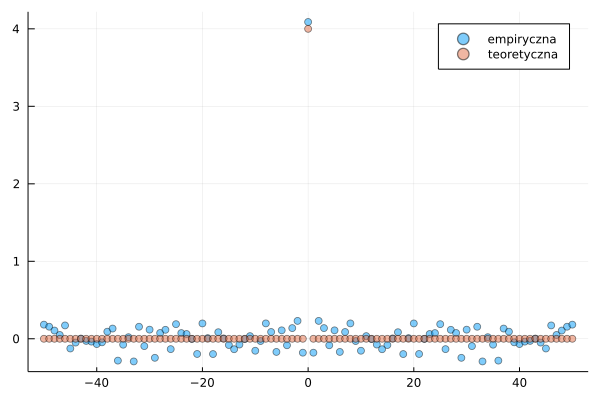

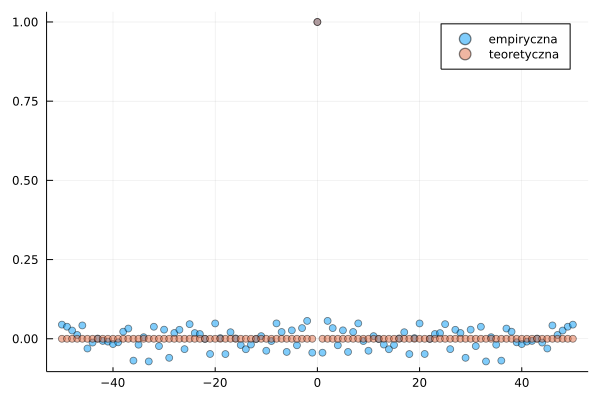

In [32]:
n = 1000
hs = -50:50
Xt = rand(Normal(0, 2), n)

γ_(h) = 1/n * sum( [ (Xt[i] - mean(Xt)) * (Xt[i + abs(h)] - mean(Xt)) for i in 1:n-abs(h) ] )
γ_s = γ_.(hs)

γ(h) = (h == 0) * 4
γs = γ.(hs)

scatter(hs, γ_s, label="empiryczna", alpha=0.5)
scatter!(hs, γs, label="teoretyczna", alpha=0.5) |> display

ρ_s = γ_s ./ γ_(0)
ρs = γs ./ γ(0)

scatter(hs, ρ_s, label="empiryczna", alpha=0.5)
scatter!(hs, ρs, label="teoretyczna", alpha=0.5)

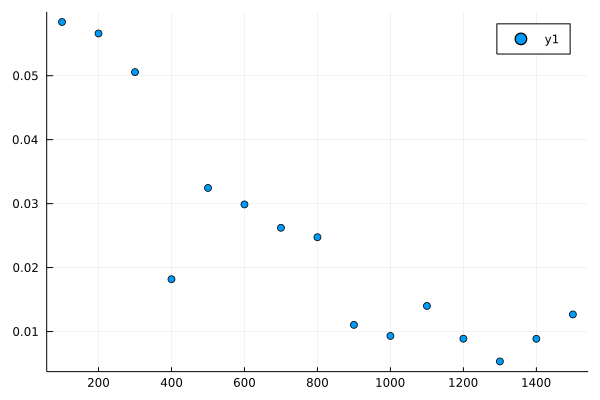

In [42]:
hs = -50:50
es = Float64[]
N = 100:100:1500

for n in N
    Xt = rand(Normal(0, 2), n)
    
    γ_(h) = 1/n * sum( [ (Xt[i] - mean(Xt)) * (Xt[i + abs(h)] - mean(Xt)) for i in 1:n-abs(h) ] )
    γ_s = γ_.(hs)

    γ(h) = (h == 0) * 4
    γs = γ.(hs)
    
    e = mean((γ_s .- γs).^2)
    append!(es, e)
end

scatter(N, es)

## Zadanie 4

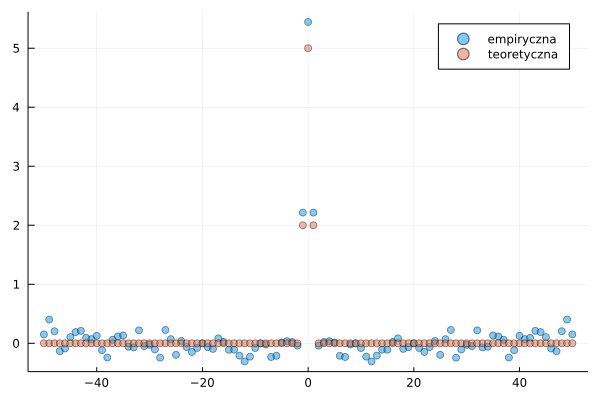

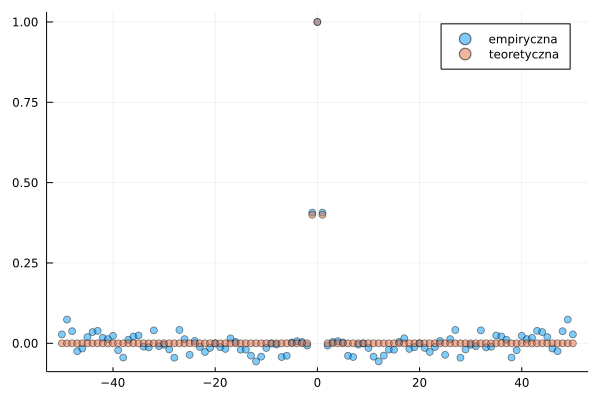

In [46]:
θ = 0.5
σ = 2
n = 1000
hs = -50:50
Zt = rand(Normal(0, σ), n + 1)
Xt = Zt[2:end] .+ θ .* Zt[1:end-1]

γ_(h) = 1/n * sum( [ (Xt[i] - mean(Xt)) * (Xt[i + abs(h)] - mean(Xt)) for i in 1:n-abs(h) ] )
γ_s = γ_.(hs)

γ(h) = (σ^2 * (1 + θ^2)) * (h == 0)  +  (σ^2 * θ) * (abs(h) == 1)
γs = γ.(hs)

scatter(hs, γ_s, label="empiryczna", alpha=0.5)
scatter!(hs, γs, label="teoretyczna", alpha=0.5) |> display

ρ_s = γ_s ./ γ_(0)
ρs = γs ./ γ(0)

scatter(hs, ρ_s, label="empiryczna", alpha=0.5)
scatter!(hs, ρs, label="teoretyczna", alpha=0.5)

## Zadanie 5

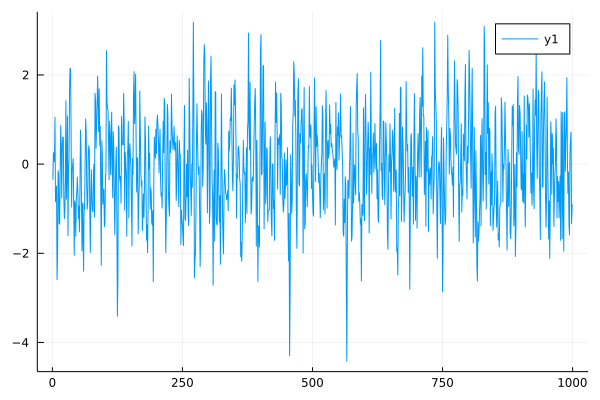

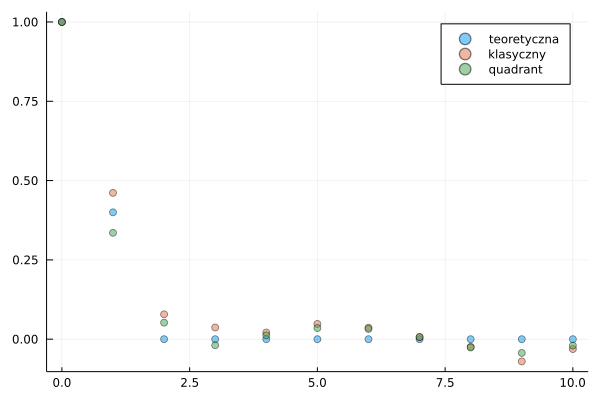

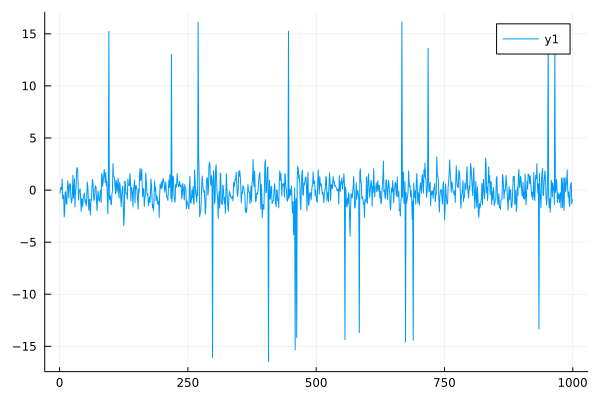

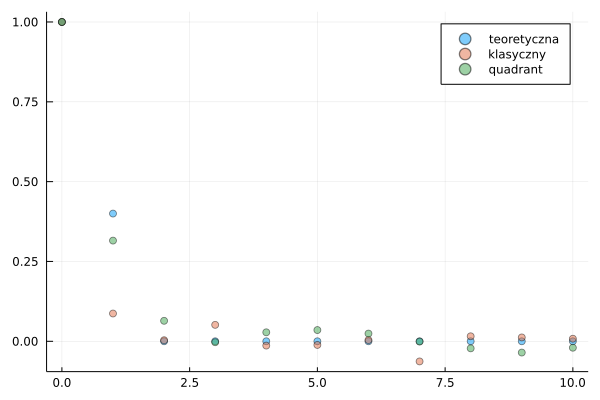

In [22]:
θ = 0.5
σ = 1
p = 0.02
a = 15
hs = 0:10
n = 1000
Zt = rand(Normal(0, σ), n + 1)
Xt = Zt[2:end] .+ θ .* Zt[1:end-1]

γ(h) = (σ^2 * (1 + θ^2)) * (h == 0)  +  (σ^2 * θ) * (abs(h) == 1)
γs = γ.(hs)
ρs = γs ./ γ(0)

γ_1(X, h) = 1/n * sum( [ (X[i] - mean(X)) * (X[i + abs(h)] - mean(X)) for i in 1:n-abs(h) ] )
γ_1s = γ_1.(Ref(Xt), hs)
ρ_1s = γ_1s ./ γ_1(Xt, 0)

ρ_2(X, h) = 1 / (n - h) * sum( [sign((X[i] - median(X)) * (X[i+h] - median(X))) for i in 1:n-h] )
ρ_2s = ρ_2.(Ref(Xt), hs)

ρ_3(X, h) = 2 / ((n - h)*(n - h -1 )) * sum( [sum( [sign((X[i] - X[j])*(X[i+h] - X[j+h])) for i in j+1:n-h] ) for j in 1:n-h-1 ])
ρ_3s = ρ_3.(Ref(Xt), hs)

plot(Xt) |> display

scatter(hs, ρs, label="teoretyczna", alpha=0.5)
scatter!(hs, ρ_1s, label="klasyczny", alpha=0.5)
scatter!(hs, ρ_2s, label="quadrant", alpha=0.5) |> display

U = rand(n)
E = (U .< p/2).*(-1*a) .+ (U .> 1 - p/2) .* a
Yt = Xt .+ E

plot(Yt) |> display

γs = γ.(hs)
ρs = γs ./ γ(0)

γ_1s = γ_1.(Ref(Yt), hs)
ρ_1s = γ_1s ./ γ_1(Yt, 0)

ρ_2s = ρ_2.(Ref(Yt), hs)

scatter(hs, ρs, label="teoretyczna", alpha=0.5)
scatter!(hs, ρ_1s, label="klasyczny", alpha=0.5)
scatter!(hs, ρ_2s, label="quadrant", alpha=0.5) |> display

# Lista 5

## Zadanie 2

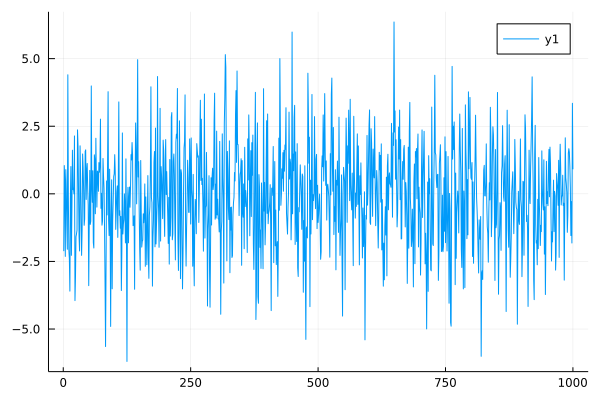

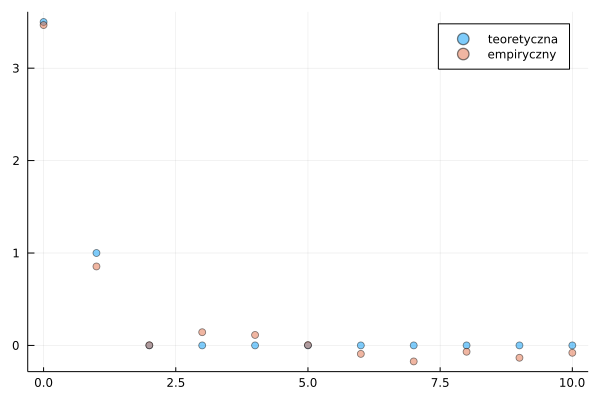

In [12]:
θ = 0.5
σz = sqrt(2)
σw = 1
hs = 0:10
n = 1000
Zt = rand(Normal(0, σz), n + 1)
Xt = Zt[2:end] .+ θ .* Zt[1:end-1]
Wt = rand(Normal(0, σw), n)
Yt = Xt + Wt

γ(h) = (σz^2 * (1 + θ^2) + σw^2) * (h == 0)  +  (σz^2 * θ) * (abs(h) == 1)
γs = γ.(hs)

γ_1(X, h) = 1/n * sum( [ (X[i] - mean(X)) * (X[i + abs(h)] - mean(X)) for i in 1:n-abs(h) ] )
γ_1s = γ_1.(Ref(Yt), hs)

plot(Yt) |> display

scatter(hs, γs, label="teoretyczna", alpha=0.5)
scatter!(hs, γ_1s, label="empiryczny", alpha=0.5)